<a href="https://colab.research.google.com/github/anvq38/AI/blob/master/18520440_Lab1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab.patches import cv2_imshow
import cv2

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3751k  100 3751k    0     0  9171k      0 --:--:-- --:--:-- --:--:-- 9171k


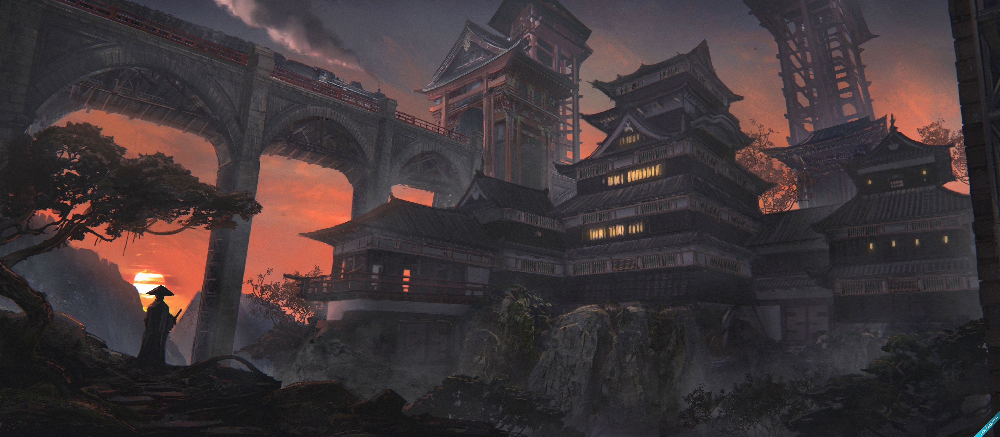

In [0]:
!curl -o Anh.jpg https://i.imgur.com/mYWuQG5.jpg
img = cv2.imread('Anh.jpg', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

In [0]:
from google.colab.patches import cv2_imshow
import cv2
import os

def download_view(img_url):
  img_file = os.path.basename(img_url)
  !curl -o $img_file $img_url
  img = cv2.imread(img_file, cv2.IMREAD_UNCHANGED)
  cv2_imshow(img)
  return img_file

https://i.imgur.com/mYWuQG5.jpg
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3751k  100 3751k    0     0  9285k      0 --:--:-- --:--:-- --:--:-- 9262k


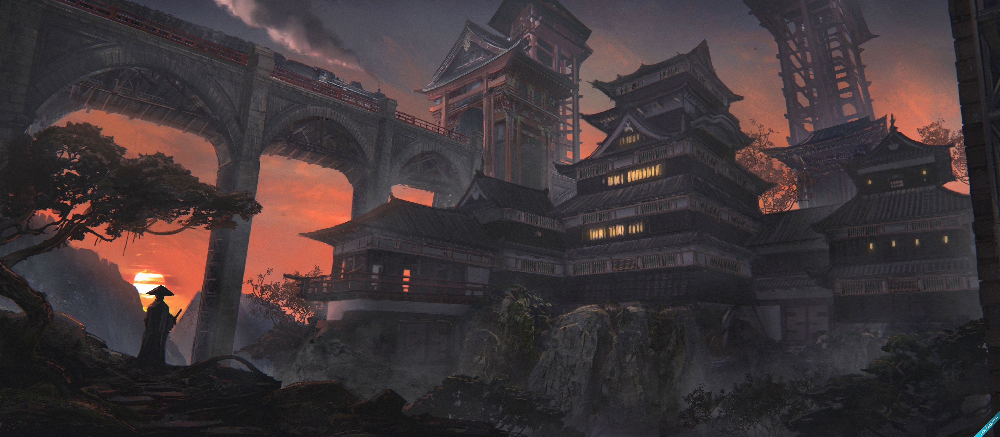

mYWuQG5.jpg


In [0]:
img_url = "https://i.imgur.com/mYWuQG5.jpg" #@param {type:"string"}

print(img_url)
img_file = download_view(img_url)
print(img_file)

In [0]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [0]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

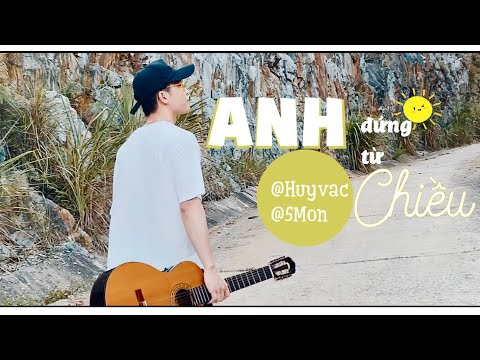

In [10]:
from IPython.display import YouTubeVideo
YouTubeVideo('VtmppczOO50')

In [11]:
from google.colab import files
uploaded = files.upload()

Saving videoplayback.mp4 to videoplayback.mp4


In [12]:
#Here's a nice way to watch a video within the notebook--will be useful
# when we want to work with videos
import io
import base64
from IPython.display import HTML

def playvideo(filename):
    video = io.open(filename, 'r+b').read()
    encoded = base64.b64encode(video)
    return HTML(data='''<video alt="test" controls>
                    <source src="data:video/mp4;base64,{0}" type="video/mp4"/>
                 </video>'''.format(encoded.decode('ascii')))
#Now play...
playvideo('videoplayback.mp4')